# Filtering of Audio Signals in Time and Frequency Domain

This code is provided as supplementary material of the lecture "Coding of Audiovisual Signals".

This code illustrates
* Filtering of audio signals

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import scipy.signal as signal
from scipy.io import wavfile
import scipy
import IPython.display as ipd
import math
from pylab import rcParams
rcParams['axes.xmargin'] = 0

In [2]:
def audio_load(filename, sr = None):
    old_sampling_rate, x = wavfile.read(filename)
    if len(x.shape) == 2:
        x = np.squeeze(x[:,0])
    x = x/32768
    if sr is not None:
        sampling_rate = sr
        number_of_samples = round(len(x) * sampling_rate / old_sampling_rate) 
        x = sp.resample(x, number_of_samples)
    else:
        sampling_rate = old_sampling_rate
    return x, sampling_rate

In [3]:
def audio_display_waveshow(y, sr, alpha = 0.8, color = 'skyblue', linewidth = 1):
    time = np.linspace(0, len(y) / sr, num=len(y))
    #plt.plot(time, y, color=color, alpha=alpha, linewidth=1)
    #plt.xlim(time[0], time[-1])
    fig, ax = plt.subplots(figsize=(14, 4))
    ax.fill_between(time, -np.abs(y), np.abs(y), color='skyblue')
    plt.xlabel("Time")


Load audio file and display it (Source of audio file: https://commons.wikimedia.org/wiki/File:Frere_Jacques_-_sujet.ogg). The original file is licensed under the Creative Commons Attribution-Share Alike 3.0 Unported license. The file has been modified by converting stereo to mono, increasing and volume and looping the audio.

In [4]:
wave_filename = '../audio/frere_jacques_loop.wav'
#wave_filename = '../audio/KIMIKO ISHIZAKA - Goldberg Variations BWV 988 - 01 - Aria_45s.wav'
audio_bruderjakob, sampling_rate = audio_load(wave_filename)

In [5]:
ipd.Audio(audio_bruderjakob, rate=sampling_rate)

We create a canon of the song "Bruder Jakob" (“Frère Jacques”) by repeating the melody every 4 seconds (the duration of one part). To do this, we generate an impulse response.
$$
h[k] = \frac{1}{2}\delta[0] + \frac{1}{2}\delta[\lfloor  4 f_{\mathsf{a}}\rfloor] + \frac{1}{2}\delta[\lfloor 8f_{\mathsf{a}} \rfloor] + \frac{1}{2}\delta[\lfloor  12 f_{\mathsf{a}}\rfloor]
$$
where the floor brackets $\lfloor x \rfloor$ denote the greatest integer less than or equal to $x$.

__Question__: Why are the individual unit impulses weighted by the factor $\frac{1}{2}$?

In [6]:
h = np.zeros(sampling_rate*13)
h[0] = 1/2
h[math.floor(4*sampling_rate)] = 1/2
h[math.floor(8*sampling_rate)] = 1/2
h[math.floor(12*sampling_rate)] = 1/2

# Faltung mit Impulsantwort
#audio_kanon = np.convolve(audio_bruderjakob, h)
audio_kanon = signal.convolve(audio_bruderjakob, h, method='fft')  # faster: method='fft', slower: method='direct'

ipd.Audio(audio_kanon, rate=sampling_rate)

We can also measure and record the impulse response of a room. For this purpose, for example, the response to a Dirac impulse (a “hand clap”) is measured. Alternatively, more suitable methods use pseudo-random sequences and are covered in various lectures, e.g., when measuring channel impulse responses in (mobile) communications.

The following figure (source: https://www.iks.rwth-aachen.de/forschung/tools-downloads/databases/aachen-impulse-response-database/) shows such a measurement setup, carried out by the IKS at RWTH Aachen University. For this purpose, a loudspeaker and an artificial head equipped with sensitive microphones were placed in the Aula Carolina in Aachen, and the impulse response was measured.

The website https://www.iks.rwth-aachen.de/en/research/tools-downloads/databases/aachen-impulse-response-database/
 describes the database (Aachen Impulse Response Database) as well as the measurement setup and procedures in detail. A databa

![image.png](https://www.iks.rwth-aachen.de/fileadmin/_processed_/0/2/csm_aird-aulacarolina_9b3ddc5b00.jpg)
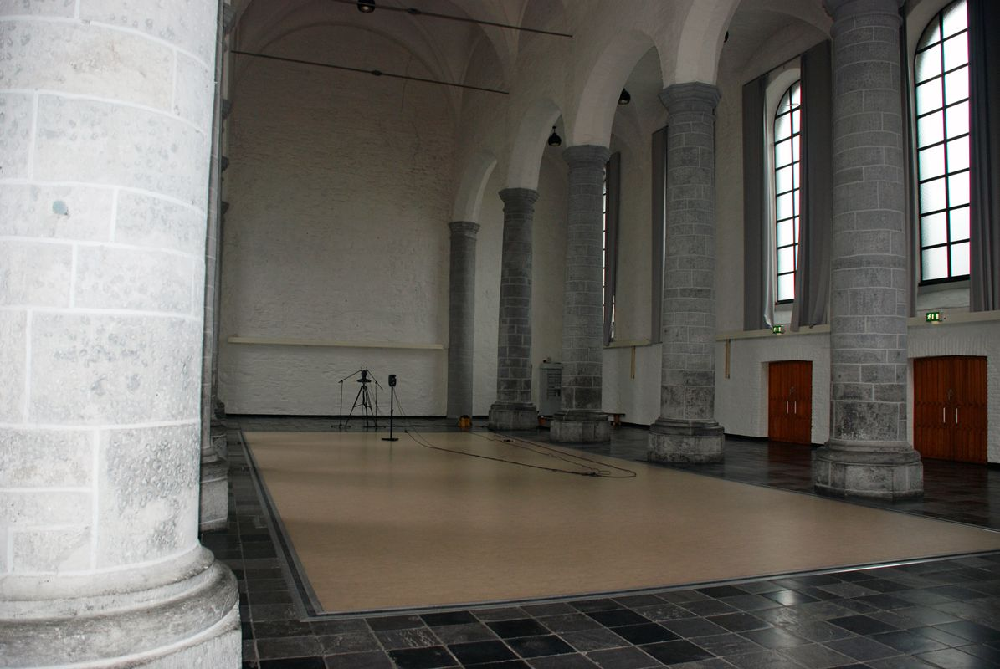

In [7]:
# Load an exemplary impulse responsed, measured in Aula Carolina
mat = scipy.io.loadmat('impulse_response_aula_carolina.mat')
h_aulacarolina = np.squeeze(mat['h_air'])

In [8]:
# Carry out the convolution with the impulse response
audio_kanon_aula = signal.convolve(audio_kanon, h_aulacarolina)
ipd.Audio(audio_kanon_aula, rate=sampling_rate)

---
Now we generate an impulse response of length $N$, with
$$
h[k] = \begin{cases}
\frac{1}{\sqrt{N}} & 0 \leq k < N \\
0 & \text{sonst} \end{cases}
$$

In [9]:
#wave_filename = './audio/33711__acclivity__excessiveexposure.wav'
#wave_filename = './audio/E-Core - Pingouin-Banquise_45s.wav'
#wave_filename = './audio/guitar_clean.wav'
wave_filename = '../audio/KIMIKO ISHIZAKA - Goldberg Variations BWV 988 - 01 - Aria_45s.wav'

audio_piano, sampling_rate = audio_load(wave_filename)
ipd.Audio(audio_piano, rate=sampling_rate)

In [10]:
N = 100;
h_avg = np.ones(N) / np.sqrt(N)

audio_avg = signal.convolve(audio_piano, h_avg)
ipd.Audio(audio_avg, rate=sampling_rate)

/tmp/ipykernel_3323/2196167987.py:3: RuntimeWarning: divide by zero encountered in log10
  plt.plot(w, 20 * np.log10(abs(h)))


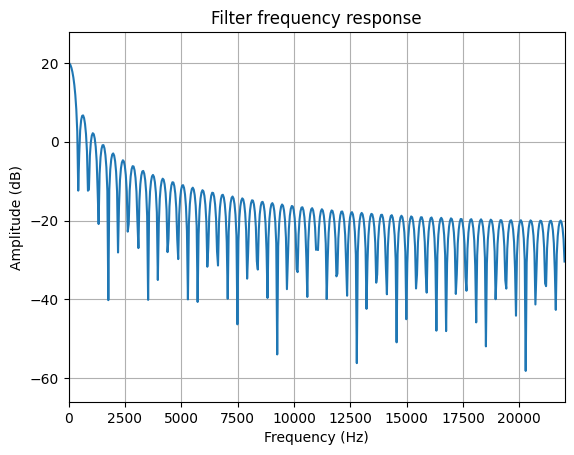

In [11]:
# show frequency response of Aula Carolina
w, h = signal.freqz(h_avg, fs=sampling_rate)
plt.plot(w, 20 * np.log10(abs(h)))
plt.title('Filter frequency response')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.show()

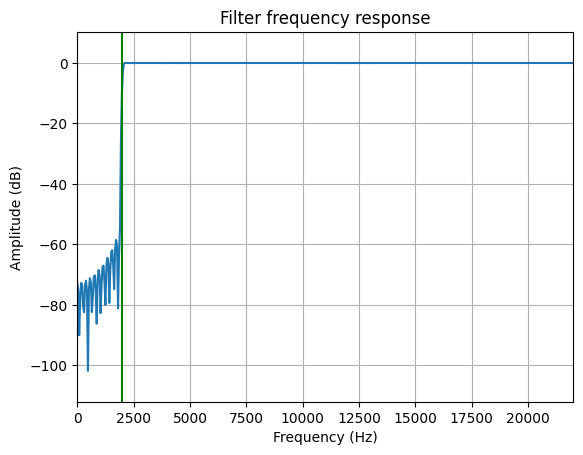

In [12]:
# define high-pass FIR filter 
# number of coefficients
N_taps = 801

# Cutoff frequency, remove everything above 1 KhZ
f_cutoff = 2000

# note that the cutoff frequency is normalized to the Nyquist frequency
taps = signal.firwin(N_taps, f_cutoff/(sampling_rate/2), pass_zero='highpass')
w, h = signal.freqz(taps, fs=sampling_rate)
plt.plot(w, 20 * np.log10(abs(h)))
plt.title('Filter frequency response')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.margins(0, 0.1)
plt.grid(which='both', axis='both')
plt.axvline(f_cutoff, color='green') # cutoff frequency
plt.show()

In [13]:
# carry out filter as a reference
y = signal.convolve(audio_piano, taps)
ipd.Audio(y, rate=sampling_rate)